<a href="https://colab.research.google.com/github/Cygnie/Stanford_Car_Object_Detection/blob/main/object_detection_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction

0. Setup colab and paths
1. Download model

# 0. Setup Colab and Paths

In [1]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%cd /content/gdrive/MyDrive/Car_Brand_OD

/content/gdrive/MyDrive/Car_Brand_OD


In [ ]:
import os
import pandas as pd
import datetime
import numpy as np

# Tensorflow Model Zoo Link

You can choose your own model for your object detection task. If you want to change the selected model, you must update these parameters.

**You can find different models in the link**

https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md

In [ ]:
CUSTOM_MODEL_NAME = 'my_ssd_mobnet' 
PRETRAINED_MODEL_NAME = 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8'
PRETRAINED_MODEL_URL = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz'
MAT2CSV_SCRIPT_NAME = "convert_mat2csv.py"
TF_RECORD_SCRIPT_NAME = 'generate_tfrecord.py'
LABEL_MAP_NAME = 'label_map.pbtxt'

In [ ]:
paths = {
    'WORKSPACE_PATH': os.path.join('Tensorflow', 'workspace'),
    'SCRIPTS_PATH': os.path.join('Tensorflow','scripts'),
    'APIMODEL_PATH': os.path.join('Tensorflow','models'),
    'ANNOTATION_PATH': os.path.join('Tensorflow', 'workspace','annotations'),
    'IMAGE_PATH': os.path.join('Tensorflow', 'workspace','images'),

    'MODEL_PATH': os.path.join('Tensorflow', 'workspace','models'),
    'PRETRAINED_MODEL_PATH': os.path.join('Tensorflow', 'workspace','pre-trained-models'),
    'CHECKPOINT_PATH': os.path.join('Tensorflow', 'workspace','models',CUSTOM_MODEL_NAME), 
    'OUTPUT_PATH': os.path.join('Tensorflow', 'workspace','models',CUSTOM_MODEL_NAME, 'export'), 
    'PROTOC_PATH':os.path.join('Tensorflow','protoc')
 }

In [ ]:
files = {
    'PIPELINE_CONFIG':os.path.join('Tensorflow', 'workspace','models', CUSTOM_MODEL_NAME, 'pipeline.config'),
    'TF_RECORD_SCRIPT': os.path.join(paths['SCRIPTS_PATH'], TF_RECORD_SCRIPT_NAME), 
    'LABELMAP': os.path.join(paths['ANNOTATION_PATH'], LABEL_MAP_NAME),
    'MAT2CSV_SCRIPT':os.path.join(paths['SCRIPTS_PATH'],MAT2CSV_SCRIPT_NAME)
}

In [ ]:
os.name

'posix'

In [ ]:
for path in paths.values():
    if not os.path.exists(path):
        if os.name == 'posix':
            !mkdir -p {path}
        if os.name == 'nt':
            !mkdir {path}

# Stanford Car Brands and Bounding Box

In [ ]:
if not os.path.exists(os.path.join(paths["IMAGE_PATH"],"car_ims")):

  if not os.path.exists(paths["IMAGE_PATH"] or {paths['ANNOTATION_PATH']}):
    !mkdir paths["IMAGE_PATH"]
    !mkdir {paths['ANNOTATION_PATH']}                                                                    
    !wget -qO- http://ai.stanford.edu/~jkrause/car196/car_ims.tgz | tar xvz -C {paths['IMAGE_PATH']}            # Download the dataset images in the IMAGES PATH and untar it.
    !wget http://ai.stanford.edu/~jkrause/car196/cars_annos.mat -P {paths['ANNOTATION_PATH']}                   # Download the dataset annotations (BBOX) to ANNOTATİON PATH

    !cd {paths['IMAGE_PATH']} && tar -zxvf {car_ims.tgz}

  else:
    !wget -qO- http://ai.stanford.edu/~jkrause/car196/car_ims.tgz | tar xvz -C {paths['IMAGE_PATH']}               
    !wget http://ai.stanford.edu/~jkrause/car196/cars_annos.mat -P {paths['ANNOTATION_PATH']}   

    !cd {paths['IMAGE_PATH']} && tar -zxvf {car_ims.tgz}


# 1. Download TF Pre-trained models from Tensorflow Model Zoo & Install TF Object Detection API

In [ ]:
if not os.path.exists(os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection')):
    !git clone https://github.com/tensorflow/models {paths['APIMODEL_PATH']}

Cloning into 'Tensorflow/models'...
remote: Enumerating objects: 80048, done.
remote: Counting objects: 100% (234/234), done.
remote: Compressing objects: 100% (138/138), done.
remote: Total 80048 (delta 112), reused 204 (delta 94), pack-reused 79814
Receiving objects: 100% (80048/80048), 594.47 MiB | 15.18 MiB/s, done.
Resolving deltas: 100% (56948/56948), done.
Checking out files: 100% (3297/3297), done.


## Installing the Tensorflow Object Detection API can be a bit of a hassle. You can use this code block for your project.

In [ ]:
# Install Tensorflow Object Detection API
if os.name=='posix':  
    !apt-get install protobuf-compiler
    !cd Tensorflow/models/research && protoc object_detection/protos/*.proto --python_out=. && cp object_detection/packages/tf2/setup.py . && python -m pip install . 
    
if os.name=='nt':
    url="https://github.com/protocolbuffers/protobuf/releases/download/v3.15.6/protoc-3.15.6-win64.zip"
    wget.download(url)
    !move protoc-3.15.6-win64.zip {paths['PROTOC_PATH']}
    !cd {paths['PROTOC_PATH']} && tar -xf protoc-3.15.6-win64.zip
    os.environ['PATH'] += os.pathsep + os.path.abspath(os.path.join(paths['PROTOC_PATH'], 'bin'))   
    !cd Tensorflow/models/research && protoc object_detection/protos/*.proto --python_out=. && copy object_detection\\packages\\tf2\\setup.py setup.py && python setup.py build && python setup.py install
    !cd Tensorflow/models/research/slim && pip install -e . 

Reading package lists... Done
Building dependency tree       
Reading state information... Done
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
The following package was automatically installed and is no longer required:
  libnvidia-common-460
Use 'apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 20 not upgraded.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/gdrive/MyDrive/Car_Brand_OD/Tensorflow/models/research
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
     |████████████████████████████████| 14.5 MB 65.0 MB/s 
     |██

In [ ]:
VERIFICATION_SCRIPT = os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection', 'builders', 'model_builder_tf2_test.py')
# Verify Installation
!python {VERIFICATION_SCRIPT}

2023-01-01 17:22:00.821713: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-01-01 17:22:02.182161: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-01 17:22:02.182372: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/lib64-nvidia
2023-01-01 17:22:02.182402: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF

## Download the specific model from Model Zoo, move it to the pre-trained models path and untar the file.

In [ ]:
if os.name =='posix':
    !wget {PRETRAINED_MODEL_URL}
    !mv {PRETRAINED_MODEL_NAME+'.tar.gz'} {paths['PRETRAINED_MODEL_PATH']}
    !cd {paths['PRETRAINED_MODEL_PATH']} && tar -zxvf {PRETRAINED_MODEL_NAME+'.tar.gz'}
if os.name == 'nt':                       # nt Mean Windows
    wget.download(PRETRAINED_MODEL_URL)
    !move {PRETRAINED_MODEL_NAME+'.tar.gz'} {paths['PRETRAINED_MODEL_PATH']}
    !cd {paths['PRETRAINED_MODEL_PATH']} && tar -zxvf {PRETRAINED_MODEL_NAME+'.tar.gz'}

--2023-01-01 17:22:54--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 172.253.118.128, 2404:6800:4003:c0f::80
Connecting to download.tensorflow.org (download.tensorflow.org)|172.253.118.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20515344 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.56M   102MB/s    in 0.2s    

2023-01-01 17:22:55 (102 MB/s) - ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’ saved [20515344/20515344]

ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu

# Prepare data for training

Stanford Car Dataset annotations file is a .mat file. csv


In [ ]:
!python {files["MAT2CSV_SCRIPT"]} -m {os.path.join(paths['ANNOTATION_PATH'],"cars_annos.mat")} -o {os.path.join(paths['ANNOTATION_PATH'])} -i {os.path.join(paths["IMAGE_PATH"],"car_ims")}

image read successfully from Tensorflow/workspace/images/car_ims
image read successfully from Tensorflow/workspace/images/car_ims
image read successfully from Tensorflow/workspace/images/car_ims
Successfully created the .csv file: Tensorflow/workspace/annotations/train_dataset.csv
Successfully created the .csv file: Tensorflow/workspace/annotations/test_dataset.csv
Successfully created the .csv file: Tensorflow/workspace/annotations/validation_dataset.csv


# We need the prepare label map for object detection models.

In [ ]:
train_dataset = pd.read_csv("Tensorflow/workspace/annotations/train_dataset.csv")
labels= {key+1:value for key,value in enumerate(train_dataset["class"].unique())}

with open(files['LABELMAP'], 'w') as f:
    for id,name in labels.items():
        f.write('item { \n')
        f.write('\tname:\'{}\'\n'.format(name))
        f.write('\tid:{}\n'.format(id))
        f.write('}\n')

In [ ]:
labels

{1: 'BMW 1 Series Convertible 2012',
 2: 'Chevrolet Silverado 1500 Classic Extended Cab 2007',
 3: 'Chrysler Crossfire Convertible 2008',
 4: 'Dodge Charger SRT-8 2009',
 5: 'Ferrari 458 Italia Convertible 2012',
 6: 'Ford F-150 Regular Cab 2007',
 7: 'Nissan NV Passenger Van 2012',
 8: 'Scion xD Hatchback 2012',
 9: 'Spyker C8 Convertible 2009'}

# Let's visualize the 1 example in the dataset.

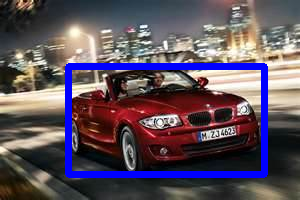

In [ ]:
from google.colab.patches import cv2_imshow                                                       # Colab doesn't support cv2.imshow() directly but we can call this function
import cv2

example = train_dataset.sample(1).values[0]                                                        # Take 1 random example in the dataset

img = cv2.imread(os.path.join(paths["IMAGE_PATH"],"car_ims",example[0]), cv2.IMREAD_UNCHANGED)     # Read the image 
start_point = (example[4],example[5])                                                              # (xmin,ymin)
end_point = (example[6],example[7])                                                                # (xmax,ymax)
cv2.rectangle(img,start_point,end_point, (255,0,0),6)                                              # Put the rectangle on it
cv2_imshow(img)

# Create TFRecord

In [ ]:
if not os.path.exists(files['TF_RECORD_SCRIPT']):
    !git pull https://github.com/nicknochnack/GenerateTFRecord {paths['SCRIPTS_PATH']}

fatal: not a git repository (or any parent up to mount point /content)
Stopping at filesystem boundary (GIT_DISCOVERY_ACROSS_FILESYSTEM not set).


In [ ]:
!python {files['TF_RECORD_SCRIPT']} -c {os.path.join(paths['ANNOTATION_PATH'],'train_dataset.csv')} -i {os.path.join(paths['IMAGE_PATH'], 'car_ims')} -l {files['LABELMAP']} -o {os.path.join(paths['ANNOTATION_PATH'], 'train.record')} 
!python {files['TF_RECORD_SCRIPT']} -c {os.path.join(paths['ANNOTATION_PATH'],'validation_dataset.csv')} -i {os.path.join(paths['IMAGE_PATH'], 'car_ims')} -l {files['LABELMAP']} -o {os.path.join(paths['ANNOTATION_PATH'], 'validation.record')} 
!python {files['TF_RECORD_SCRIPT']} -c {os.path.join(paths['ANNOTATION_PATH'],'test_dataset.csv')} -i {os.path.join(paths['IMAGE_PATH'], 'car_ims')} -l {files['LABELMAP']} -o {os.path.join(paths['ANNOTATION_PATH'], 'test.record')} 

Successfully created the TFRecord file: Tensorflow/workspace/annotations/train.record
Successfully created the TFRecord file: Tensorflow/workspace/annotations/validation.record
Successfully created the TFRecord file: Tensorflow/workspace/annotations/test.record


# Delete the unnecessary files.

In [ ]:
!rm {os.path.join(paths['ANNOTATION_PATH'],'train_dataset.csv')}
!rm {os.path.join(paths['ANNOTATION_PATH'],'validation_dataset.csv')}
!rm {os.path.join(paths['ANNOTATION_PATH'],'test_dataset.csv')}
!rm {os.path.join(paths['ANNOTATION_PATH'],'cars_annos.mat')}

# Copy Model Config to Training Folder

In [ ]:
if os.name =='posix':
    !cp {os.path.join(paths['PRETRAINED_MODEL_PATH'], PRETRAINED_MODEL_NAME, 'pipeline.config')} {os.path.join(paths['CHECKPOINT_PATH'])}
if os.name == 'nt':
    !copy {os.path.join(paths['PRETRAINED_MODEL_PATH'], PRETRAINED_MODEL_NAME, 'pipeline.config')} {os.path.join(paths['CHECKPOINT_PATH'])}

# Update Config For Transfer Learning

In [ ]:
import tensorflow as tf
from object_detection.utils import config_util
from object_detection.protos import pipeline_pb2
from google.protobuf import text_format
from object_detection.utils import label_map_util

In [ ]:
config = config_util.get_configs_from_pipeline_file(files['PIPELINE_CONFIG'])
config

{'model': ssd {
   num_classes: 90
   image_resizer {
     fixed_shape_resizer {
       height: 320
       width: 320
     }
   }
   feature_extractor {
     type: "ssd_mobilenet_v2_fpn_keras"
     depth_multiplier: 1.0
     min_depth: 16
     conv_hyperparams {
       regularizer {
         l2_regularizer {
           weight: 3.9999998989515007e-05
         }
       }
       initializer {
         random_normal_initializer {
           mean: 0.0
           stddev: 0.009999999776482582
         }
       }
       activation: RELU_6
       batch_norm {
         decay: 0.996999979019165
         scale: true
         epsilon: 0.0010000000474974513
       }
     }
     use_depthwise: true
     override_base_feature_extractor_hyperparams: true
     fpn {
       min_level: 3
       max_level: 7
       additional_layer_depth: 128
     }
   }
   box_coder {
     faster_rcnn_box_coder {
       y_scale: 10.0
       x_scale: 10.0
       height_scale: 5.0
       width_scale: 5.0
     }
   }
   matc

In [ ]:
NUM_CLASS = len(label_map_util.create_category_index_from_labelmap(os.path.join(paths['ANNOTATION_PATH'],"label_map.pbtxt")))
NUM_CLASS

9

In [ ]:
pipeline_config = pipeline_pb2.TrainEvalPipelineConfig()
with tf.io.gfile.GFile(files['PIPELINE_CONFIG'], "r") as f:                                                                                                                                                                                                                     
    proto_str = f.read()                                                                                                                                                                                                                                          
    text_format.Merge(proto_str, pipeline_config)  

In [ ]:
pipeline_config.model.ssd.num_classes = NUM_CLASS
pipeline_config.train_config.batch_size = 8
pipeline_config.train_config.fine_tune_checkpoint = os.path.join(paths['PRETRAINED_MODEL_PATH'], PRETRAINED_MODEL_NAME, 'checkpoint', 'ckpt-0')
pipeline_config.train_config.fine_tune_checkpoint_type = "detection"
pipeline_config.train_input_reader.label_map_path= os.path.join(paths['ANNOTATION_PATH'],"label_map.pbtxt")
pipeline_config.train_input_reader.tf_record_input_reader.input_path[:] = [os.path.join(paths['ANNOTATION_PATH'],'train.record')]
pipeline_config.eval_input_reader[0].label_map_path = os.path.join(paths['ANNOTATION_PATH'],"label_map.pbtxt")
pipeline_config.eval_input_reader[0].tf_record_input_reader.input_path[:] = [os.path.join(paths['ANNOTATION_PATH'],'validation.record')]

In [ ]:
config_text = text_format.MessageToString(pipeline_config)                                                                                                                                                                                                        
with tf.io.gfile.GFile(files['PIPELINE_CONFIG'], "wb") as f:                                                                                                                                                                                                                   
    f.write(config_text)   

In [ ]:
pipeline_config

model {
  ssd {
    num_classes: 9
    image_resizer {
      fixed_shape_resizer {
        height: 320
        width: 320
      }
    }
    feature_extractor {
      type: "ssd_mobilenet_v2_fpn_keras"
      depth_multiplier: 1.0
      min_depth: 16
      conv_hyperparams {
        regularizer {
          l2_regularizer {
            weight: 3.9999998989515007e-05
          }
        }
        initializer {
          random_normal_initializer {
            mean: 0.0
            stddev: 0.009999999776482582
          }
        }
        activation: RELU_6
        batch_norm {
          decay: 0.996999979019165
          scale: true
          epsilon: 0.0010000000474974513
        }
      }
      use_depthwise: true
      override_base_feature_extractor_hyperparams: true
      fpn {
        min_level: 3
        max_level: 7
        additional_layer_depth: 128
      }
    }
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
 

# Train the model

In [ ]:
TRAINING_SCRIPT = os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection', 'model_main_tf2.py')

In [ ]:
command = "python {} --model_dir={} --pipeline_config_path={} --num_train_steps=3000".format(TRAINING_SCRIPT, paths['CHECKPOINT_PATH'],files['PIPELINE_CONFIG'])

In [ ]:
print(command)

python Tensorflow/models/research/object_detection/model_main_tf2.py --model_dir=Tensorflow/workspace/models/my_ssd_mobnet --pipeline_config_path=Tensorflow/workspace/models/my_ssd_mobnet/pipeline.config --num_train_steps=3000


In [ ]:
!{command}

2023-01-01 17:36:42.937472: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2023-01-01 17:36:42.937604: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2023-01-01 17:36:42.937624: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-01-01 17:36:47.051598: W tensorflow/core/common_runt

# Tensorboard

In [ ]:
%load_ext tensorboard
%cd {os.path.join(paths['MODEL_PATH'],'my_ssd_mobnet','train')}
%tensorboard --logdir=.

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
/content/gdrive/MyDrive/Car_Brand_OD/Tensorflow/workspace/models/my_ssd_mobnet/train


<IPython.core.display.Javascript object>

When I see the Tensorboard results, I can tell that 3000 epochs is too much for this dataset. The model overfitting the train data.

# Evaulate the model

In [ ]:
%cd /content/gdrive/MyDrive/Car_Brand_OD/

/content/gdrive/MyDrive/Car_Brand_OD


In [ ]:
command = "python {} --model_dir={} --pipeline_config_path={} --checkpoint_dir={}".format(TRAINING_SCRIPT, paths['CHECKPOINT_PATH'],files['PIPELINE_CONFIG'], paths['CHECKPOINT_PATH'])

In [ ]:
print(command)

python Tensorflow/models/research/object_detection/model_main_tf2.py --model_dir=Tensorflow/workspace/models/my_ssd_mobnet --pipeline_config_path=Tensorflow/workspace/models/my_ssd_mobnet/pipeline.config --checkpoint_dir=Tensorflow/workspace/models/my_ssd_mobnet


In [ ]:
!{command}

2023-01-01 17:57:05.693102: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2023-01-01 17:57:05.693216: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2023-01-01 17:57:05.693243: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
W0101 17:57:08.716058 140191175710592 model_lib_v2.py:108

# Tensorboard for Evaluate the Model

In [ ]:
%load_ext tensorboard
%cd {os.path.join(paths['MODEL_PATH'],'my_ssd_mobnet','eval')}
%tensorboard --logdir=.

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard
/content/gdrive/MyDrive/Car_Brand_OD/Tensorflow/workspace/models/my_ssd_mobnet/eval


<IPython.core.display.Javascript object>

## Since our model was trained with little data, we expect the predictions to not be very good.

  * When we test our model on the test data, it makes errors as we expected as a result of the train results and the little data.

# Load Trained Model From Checkpoint

In [ ]:
%cd /content/gdrive/MyDrive/Car_Brand_OD/

/content/gdrive/MyDrive/Car_Brand_OD


In [ ]:
import os
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder
from object_detection.utils import config_util

In [ ]:
# Load pipeline config and build a detection model
configs = config_util.get_configs_from_pipeline_file(files['PIPELINE_CONFIG'])
detection_model = model_builder.build(model_config=configs['model'], is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)

#@markdown Follow the path and find the last Checkpoint "Tensorflow/workspace/models/my_ssd_mobnet/train" 
last_ckpt = 'ckpt-5'  #@param ["ckpt-1","ckpt-2","ckpt-3","ckpt-4","ckpt-5"]
ckpt.restore(os.path.join(paths['CHECKPOINT_PATH'],last_ckpt)).expect_partial()

@tf.function
def detect_fn(image):
    image, shapes = detection_model.preprocess(image)
    prediction_dict = detection_model.predict(image, shapes)
    detections = detection_model.postprocess(prediction_dict, shapes)
    return detections

# Detect from an image

In [ ]:
import cv2 
import numpy as np
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
%matplotlib inline

In [ ]:
category_index = label_map_util.create_category_index_from_labelmap(files['LABELMAP'])

# Choose the data and look at the results.

In [ ]:
def predict_results(img_path):
  img = cv2.imread(img_path)
  image_np = np.array(img)

  input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
  detections = detect_fn(input_tensor)

  num_detections = int(detections.pop('num_detections'))
  detections = {key: value[0, :num_detections].numpy()
                for key, value in detections.items()}
  detections['num_detections'] = num_detections

  # detection_classes should be ints.
  detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

  label_id_offset = 1
  image_np_with_detections = image_np.copy()

  viz_utils.visualize_boxes_and_labels_on_image_array(
              image_np_with_detections,
              detections['detection_boxes'],
              detections['detection_classes']+label_id_offset,
              detections['detection_scores'],
              category_index,
              use_normalized_coordinates=True,
              max_boxes_to_draw=5,
              min_score_thresh=.8,
              agnostic_mode=False)

  plt.imshow(cv2.cvtColor(image_np_with_detections, cv2.COLOR_BGR2RGB))
  plt.show()

## Remember, the mat2csv.py script randomly picks classes. You should look at which class you have.

In [ ]:
category_index

{1: {'id': 1, 'name': 'BMW 1 Series Convertible 2012'},
 2: {'id': 2, 'name': 'Chevrolet Silverado 1500 Classic Extended Cab 2007'},
 3: {'id': 3, 'name': 'Chrysler Crossfire Convertible 2008'},
 4: {'id': 4, 'name': 'Dodge Charger SRT-8 2009'},
 5: {'id': 5, 'name': 'Ferrari 458 Italia Convertible 2012'},
 6: {'id': 6, 'name': 'Ford F-150 Regular Cab 2007'},
 7: {'id': 7, 'name': 'Nissan NV Passenger Van 2012'},
 8: {'id': 8, 'name': 'Scion xD Hatchback 2012'},
 9: {'id': 9, 'name': 'Spyker C8 Convertible 2009'}}

In [ ]:
# Upload external image to the colab
from google.colab import files as fs
uploaded = fs.upload()

Instructions for updating:
Lambda fuctions will be no more assumed to be used in the statement where they are used, or at least in the same block. https://github.com/tensorflow/tensorflow/issues/56089


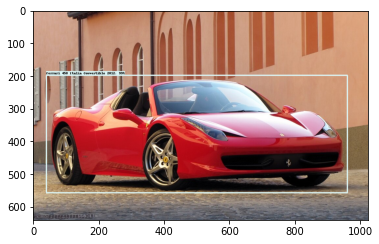

In [ ]:
IMG_PATH = "/content/gdrive/MyDrive/Car_Brand_OD/083252_2012_Ferrari_F458_Spider.jpg"  #@param {type:"string"}
predict_results(IMG_PATH)

# Freezing the graph

In [ ]:
FREEZE_SCRIPT = os.path.join(paths['APIMODEL_PATH'], 'research', 'object_detection', 'exporter_main_v2.py ')

In [ ]:
command = "python {} --input_type=image_tensor --pipeline_config_path={} --trained_checkpoint_dir={} --output_directory={}".format(FREEZE_SCRIPT ,files['PIPELINE_CONFIG'], paths['CHECKPOINT_PATH'], paths['OUTPUT_PATH'])
print(command)

python Tensorflow/models/research/object_detection/exporter_main_v2.py  --input_type=image_tensor --pipeline_config_path=Tensorflow/workspace/models/my_ssd_mobnet/pipeline.config --trained_checkpoint_dir=Tensorflow/workspace/models/my_ssd_mobnet --output_directory=Tensorflow/workspace/models/my_ssd_mobnet/export


In [ ]:
!{command}

2023-01-01 18:54:45.030339: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2023-01-01 18:54:45.030481: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/lib/python3.8/dist-packages/cv2/../../lib64:/usr/lib64-nvidia
2023-01-01 18:54:45.030501: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nvidia GPU with TensorRT, please make sure the missing libraries mentioned above are installed properly.
2023-01-01 18:54:49.451290: W tensorflow/core/common_runt

# Zip and Export Model

In [ ]:
!tar -czf models.tar.gz {paths['CHECKPOINT_PATH']}